# The Sparks Foundation Internship

## Data Science & Business Analytics PATH
## Author: Ayoub Berdeddouch

### Task 4: Exploratory Data Analysis - Terrorism (Level - Intermediate)





In [3]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
#from mpl_toolkits.basemap import Basemap
import matplotlib.animation as animation
from IPython.display import HTML
import warnings
warnings.filterwarnings('ignore')


import plotly.graph_objs as go
import plotly.tools as tls
import folium
import folium.plugins
from matplotlib import animation,rc
import io
import base64

In [4]:
# Reading data 
df_terrorism = pd.read_csv('globalterrorismdb_0718dist.csv', encoding="latin1")
print("Data imported successfully")

df_terrorism.head(10)


Data imported successfully


,eventid,iyear,imonth,iday,approxdate,extended,resolution,country,country_txt,region,...,addnotes,scite1,scite2,scite3,dbsource,INT_LOG,INT_IDEO,INT_MISC,INT_ANY,related
0,197000000001,1970,7,2,NaN,0,NaN,58,Dominican Republic,2,...,NaN,NaN,NaN,NaN,PGIS,0,0,0,0,NaN
1,197000000002,1970,0,0,NaN,0,NaN,130,Mexico,1,...,NaN,NaN,NaN,NaN,PGIS,0,1,1,1,NaN
2,197001000001,1970,1,0,NaN,0,NaN,160,Philippines,5,...,NaN,NaN,NaN,NaN,PGIS,-9,-9,1,1,NaN
3,197001000002,1970,1,0,NaN,0,NaN,78,Greece,8,...,NaN,NaN,NaN,NaN,PGIS,-9,-9,1,1,NaN
4,197001000003,1970,1,0,NaN,0,NaN,101,Japan,4,...,NaN,NaN,NaN,NaN,PGIS,-9,-9,1,1,NaN
5,197001010002,1970,1,1,NaN,0,NaN,217,United States,1,...,"The Cairo Chief of Police, William Petersen, r...","""Police Chief Quits,"" Washington Post, January...","""Cairo Police Chief Quits; Decries Local 'Mili...","Christopher Hewitt, ""Political Violence and Te...",Hewitt Project,-9,-9,0,-9,NaN
6,197001020001,1970,1,2,NaN,0,NaN,218,Uruguay,3,...,NaN,NaN,NaN,NaN,PGIS,0,0,0,0,NaN
7,197001020002,1970,1,2,NaN,0,NaN,217,United States,1,...,"Damages were estimated to be between $20,000-$...",Committee on Government Operations United Stat...,"Christopher Hewitt, ""Political Violence and Te...",NaN,Hewitt Project,-9,-9,0,-9,NaN
8,197001020003,1970,1,2,NaN,0,NaN,217,United States,1,...,The New Years Gang issue a communiqué to a loc...,"Tom Bates, ""Rads: The 1970 Bombing of the Army...","David Newman, Sandra Sutherland, and Jon Stewa...","The Wisconsin Cartographers' Guild, ""Wisconsin...",Hewitt Project,0,0,0,0,NaN
9,197001030001,1970,1,3,NaN,0,NaN,217,United States,1,...,"Karl Armstrong's girlfriend, Lynn Schultz, dro...",Committee on Government Operations United Stat...,"Tom Bates, ""Rads: The 1970 Bombing of the Army...","David Newman, Sandra Sutherland, and Jon Stewa...",Hewitt Project,0,0,0,0,NaN


In [5]:
df_terrorism.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 181691 entries, 0 to 181690
Columns: 135 entries, eventid to related
dtypes: float64(55), int64(22), object(58)
memory usage: 187.1+ MB


In [6]:
df_terrorism.describe()

,eventid,iyear,imonth,iday,extended,country,region,latitude,longitude,specificity,...,ransomamt,ransomamtus,ransompaid,ransompaidus,hostkidoutcome,nreleased,INT_LOG,INT_IDEO,INT_MISC,INT_ANY
count,1.816910e+05,181691.000000,181691.000000,181691.000000,181691.000000,181691.000000,181691.000000,177135.000000,1.771340e+05,181685.000000,...,1.350000e+03,5.630000e+02,7.740000e+02,552.000000,10991.000000,10400.000000,181691.000000,181691.000000,181691.000000,181691.000000
mean,2.002705e+11,2002.638997,6.467277,15.505644,0.045346,131.968501,7.160938,23.498343,-4.586957e+02,1.451452,...,3.172530e+06,5.784865e+05,7.179437e+05,240.378623,4.629242,-29.018269,-4.543731,-4.464398,0.090010,-3.945952
std,1.325957e+09,13.259430,3.388303,8.814045,0.208063,112.414535,2.933408,18.569242,2.047790e+05,0.995430,...,3.021157e+07,7.077924e+06,1.014392e+07,2940.967293,2.035360,65.720119,4.543547,4.637152,0.568457,4.691325
min,1.970000e+11,1970.000000,0.000000,0.000000,0.000000,4.000000,1.000000,-53.154613,-8.618590e+07,1.000000,...,-9.900000e+01,-9.900000e+01,-9.900000e+01,-99.000000,1.000000,-99.000000,-9.000000,-9.000000,-9.000000,-9.000000
25%,1.991021e+11,1991.000000,4.000000,8.000000,0.000000,78.000000,5.000000,11.510046,4.545640e+00,1.000000,...,0.000000e+00,0.000000e+00,-9.900000e+01,0.000000,2.000000,-99.000000,-9.000000,-9.000000,0.000000,-9.000000
50%,2.009022e+11,2009.000000,6.000000,15.000000,0.000000,98.000000,6.000000,31.467463,4.324651e+01,1.000000,...,1.500000e+04,0.000000e+00,0.000000e+00,0.000000,4.000000,0.000000,-9.000000,-9.000000,0.000000,0.000000
75%,2.014081e+11,2014.000000,9.000000,23.000000,0.000000,160.000000,10.000000,34.685087,6.871033e+01,1.000000,...,4.000000e+05,0.000000e+00,1.273412e+03,0.000000,7.000000,1.000000,0.000000,0.000000,0.000000,0.000000
max,2.017123e+11,2017.000000,12.000000,31.000000,1.000000,1004.000000,12.000000,74.633553,1.793667e+02,5.000000,...,1.000000e+09,1.320000e+08,2.750000e+08,48000.000000,7.000000,2769.000000,1.000000,1.000000,1.000000,1.000000


In [7]:
# Renaming some columns
df_terrorism.rename(columns={'iyear':'Year','imonth':'Month','iday':'Day','country_txt':'Country','region_txt':'Region','attacktype1_txt':'AttackType','target1':'Target','nkill':'Killed','nwound':'Wounded','summary':'Summary','gname':'Group','targtype1_txt':'Target_type','weaptype1_txt':'Weapon_type','motive':'Motive'},inplace=True)

df_terrorism=df_terrorism[['Year','Month','Day','Country','Region','city','latitude','longitude','AttackType','Killed','Wounded','Target','Summary','Group','Target_type','Weapon_type','Motive']]
df_terrorism['casualities']=df_terrorism['Killed']+df_terrorism['Wounded']

In [8]:
df_terrorism.head()

,Year,Month,Day,Country,Region,city,latitude,longitude,AttackType,Killed,Wounded,Target,Summary,Group,Target_type,Weapon_type,Motive,casualities
0,1970,7,2,Dominican Republic,Central America & Caribbean,Santo Domingo,18.456792,-69.951164,Assassination,1.0,0.0,Julio Guzman,NaN,MANO-D,Private Citizens & Property,Unknown,NaN,1.0
1,1970,0,0,Mexico,North America,Mexico city,19.371887,-99.086624,Hostage Taking (Kidnapping),0.0,0.0,"Nadine Chaval, daughter",NaN,23rd of September Communist League,Government (Diplomatic),Unknown,NaN,0.0
2,1970,1,0,Philippines,Southeast Asia,Unknown,15.478598,120.599741,Assassination,1.0,0.0,Employee,NaN,Unknown,Journalists & Media,Unknown,NaN,1.0
3,1970,1,0,Greece,Western Europe,Athens,37.997490,23.762728,Bombing/Explosion,NaN,NaN,U.S. Embassy,NaN,Unknown,Government (Diplomatic),Explosives,NaN,NaN
4,1970,1,0,Japan,East Asia,Fukouka,33.580412,130.396361,Facility/Infrastructure Attack,NaN,NaN,U.S. Consulate,NaN,Unknown,Government (Diplomatic),Incendiary,NaN,NaN


In [9]:
df_terrorism.isnull().sum()

Year                0
Month               0
Day                 0
Country             0
Region              0
city              434
latitude         4556
longitude        4557
AttackType          0
Killed          10313
Wounded         16311
Target            636
Summary         66129
Group               0
Target_type         0
Weapon_type         0
Motive         131130
casualities     16874
dtype: int64

## Basic Analysis

In [10]:
print('Country with Highest Terrorist Attacks:',df_terrorism['Country'].value_counts().index[0])
print('Regions with Highest Terrorist Attacks:',df_terrorism['Region'].value_counts().index[0])
print('Maximum people killed in an attack are:',df_terrorism['Killed'].max(),'that took place in',df_terrorism.loc[df_terrorism['Killed'].idxmax()].Country)

Country with Highest Terrorist Attacks: Iraq
Regions with Highest Terrorist Attacks: Middle East & North Africa
Maximum people killed in an attack are: 1570.0 that took place in Iraq


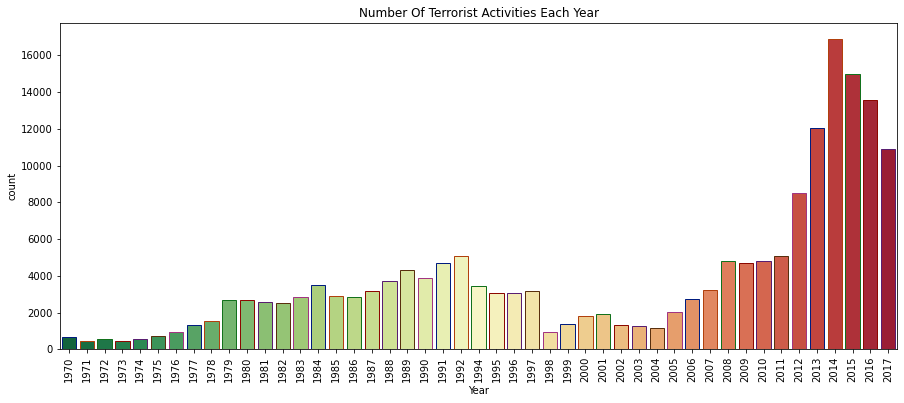

In [11]:
plt.subplots(figsize=(15,6))
sns.countplot('Year',data=df_terrorism,palette='RdYlGn_r',edgecolor=sns.color_palette('dark',7))
plt.xticks(rotation=90)
plt.title('Number Of Terrorist Activities Each Year')
plt.show()

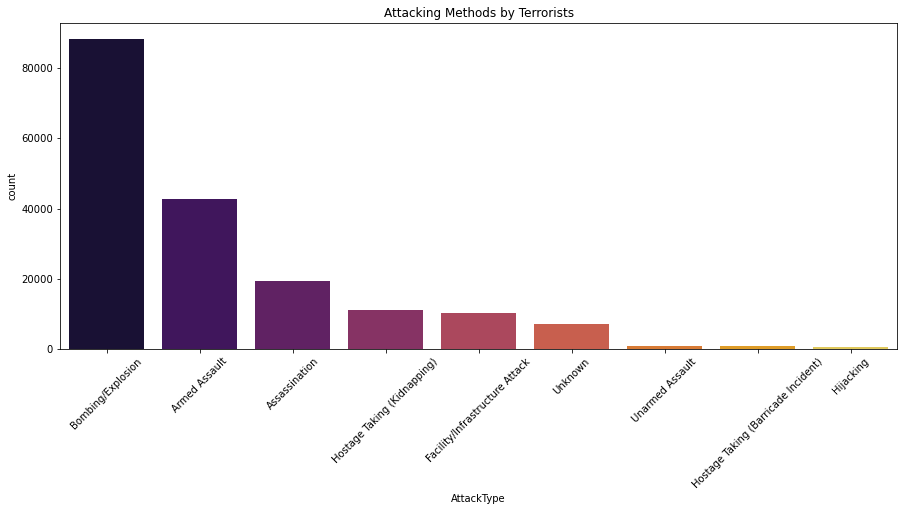

In [12]:
plt.subplots(figsize=(15,6))
sns.countplot('AttackType',data=df_terrorism,palette='inferno',order=df_terrorism['AttackType'].value_counts().index)
plt.xticks(rotation=45)
plt.title('Attacking Methods by Terrorists')
plt.show()

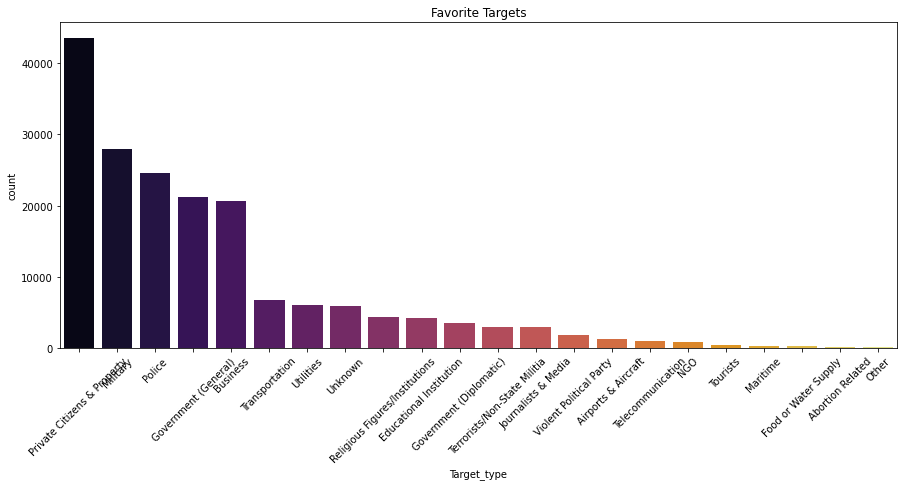

In [13]:
plt.subplots(figsize=(15,6))
sns.countplot(df_terrorism['Target_type'],palette='inferno',order=df_terrorism['Target_type'].value_counts().index)
plt.xticks(rotation=45)
plt.title('Favorite Targets')
plt.show()

In [15]:
terror_fol=df_terrorism.copy()
terror_fol.dropna(subset=['latitude','longitude'],inplace=True)
location_fol=terror_fol[['latitude','longitude']][:5000]
country_fol=terror_fol['Country'][:5000]
city_fol=terror_fol['city'][:5000]
killed_fol=terror_fol['Killed'][:5000]
wound_fol=terror_fol['Wounded'][:5000]
def color_point(x):
    if x>=30:
        color='red'
    elif ((x>0 and x<30)):
        color='blue'
    else:
        color='green'
    return color   
def point_size(x):
    if (x>30 and x<100):
        size=2
    elif (x>=100 and x<500):
        size=8
    elif x>=500:
        size=16
    else:
        size=0.5
    return size   
map2 = folium.Map(location=[30,0],tiles='CartoDB dark_matter',zoom_start=2)
for point in location_fol.index:
    info='<b>Country: </b>'+str(country_fol[point])+'<br><b>City: </b>: '+str(city_fol[point])+'<br><b>Killed </b>: '+str(killed_fol[point])+'<br><b>Wounded</b> : '+str(wound_fol[point])
    iframe = folium.IFrame(html=info, width=200, height=200)
    folium.CircleMarker(list(location_fol.loc[point].values),popup=folium.Popup(iframe),radius=point_size(killed_fol[point]),color=color_point(killed_fol[point])).add_to(map2)
map2

    The color and size of each point is according to the number of people killed in the attack. Click on each point to get more information about the attack.

## Terrorism By Region

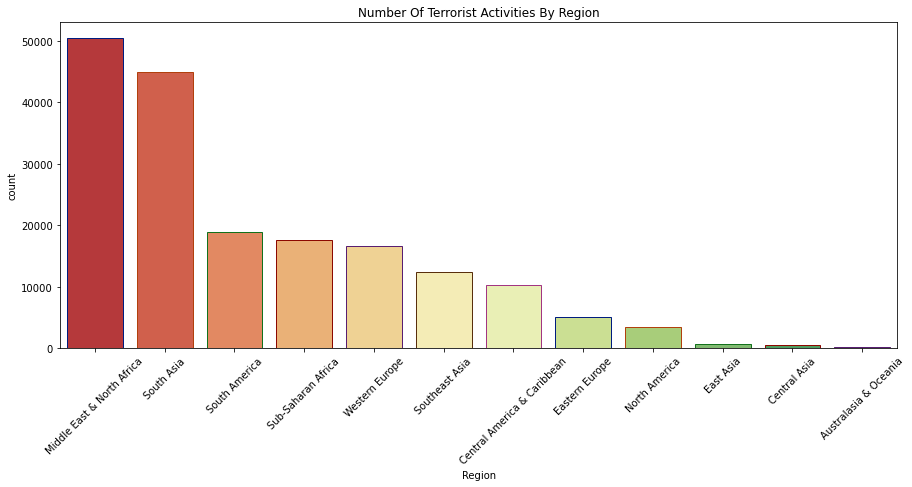

In [16]:
plt.subplots(figsize=(15,6))
sns.countplot('Region',data=df_terrorism,palette='RdYlGn',edgecolor=sns.color_palette('dark',7),order=df_terrorism['Region'].value_counts().index)
plt.xticks(rotation=45)
plt.title('Number Of Terrorist Activities By Region')
plt.show()

Middle East and North Africa are the most terrorism prone regions followed by South Asia. The Australian Region have experienced very few terrorist events. Collectively we can say that The African and Asian Continent experience the highest terrorist attacks. But why are these regions prone to terrorism? Does this have any relation to the mindset of the people? or any other reason??

### Trend in Terrorist Activities


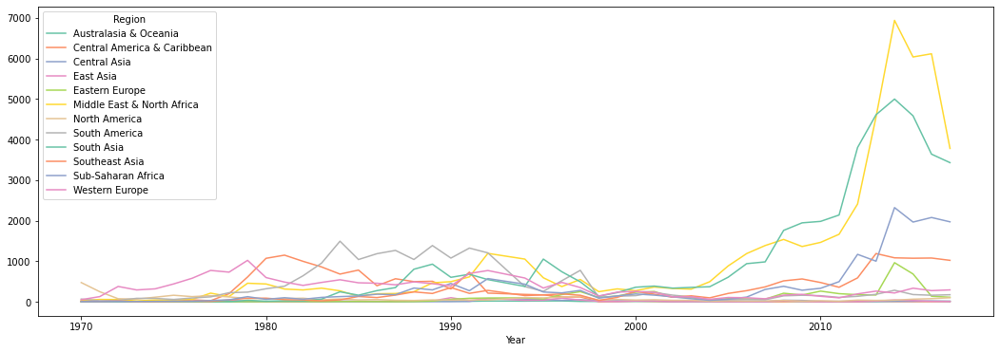

In [17]:
terror_region=pd.crosstab(df_terrorism.Year,df_terrorism.Region)
terror_region.plot(color=sns.color_palette('Set2',12))
fig=plt.gcf()
fig.set_size_inches(18,6)
plt.show()

As seen already, Middle-East,North Africa,South Asia have seen a shoot in the number of terrorist activities over the years.

### AttackType vs Region

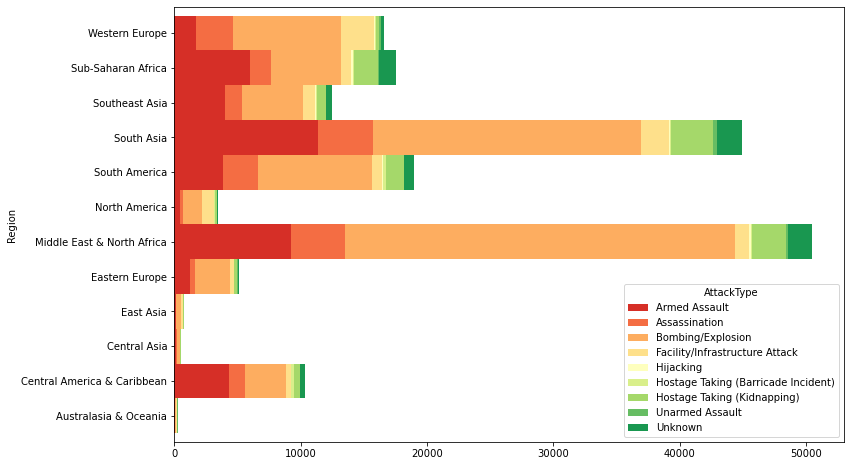

In [18]:
pd.crosstab(df_terrorism.Region,df_terrorism.AttackType).plot.barh(stacked=True,width=1,color=sns.color_palette('RdYlGn',9))
fig=plt.gcf()
fig.set_size_inches(12,8)
plt.show()

### Terrorism By Country

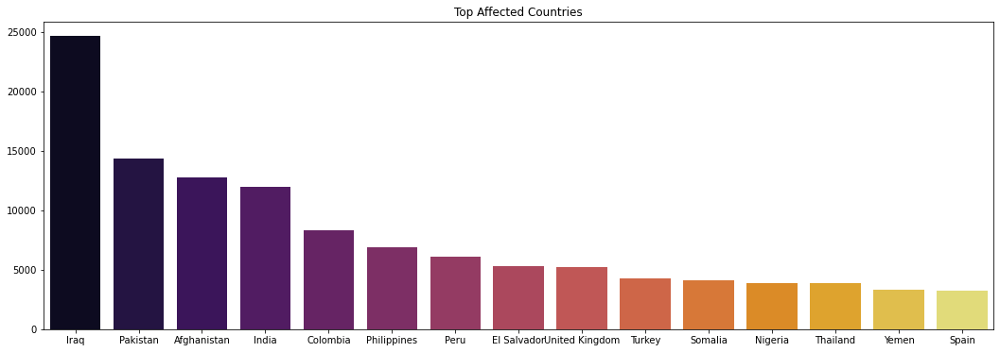

In [19]:
plt.subplots(figsize=(18,6))
sns.barplot(df_terrorism['Country'].value_counts()[:15].index,df_terrorism['Country'].value_counts()[:15].values,palette='inferno')
plt.title('Top Affected Countries')
plt.show()

Iraq has witnessed a very large number of terrorist activities followed by Pakistan. One thing to note is the countries with highest attacks, are mostly densely populated countries, thus it will eventually claim many lives. Let's check

### Attack VS Killed

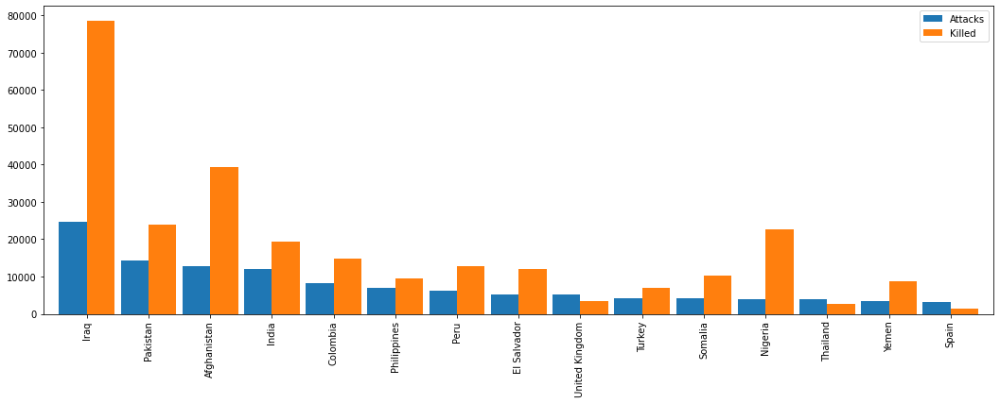

In [20]:
coun_terror=df_terrorism['Country'].value_counts()[:15].to_frame()
coun_terror.columns=['Attacks']
coun_kill=df_terrorism.groupby('Country')['Killed'].sum().to_frame()
coun_terror.merge(coun_kill,left_index=True,right_index=True,how='left').plot.bar(width=0.9)
fig=plt.gcf()
fig.set_size_inches(18,6)
plt.show()

Emmmm!! Look at the killed bar for Iraq. The number of killed is almost 3 folds more than attacks for Iraq. Thus the densely populated theory holds good.

In [21]:
# Total Terrorist Activites By Country

In [22]:
l1=list(['Afghanistan', 'Albania', 'Algeria', 'American Samoa', 'Andorra','Angola', 'Anguilla', 'Antigua and Barbuda', 'Argentina', 'Armenia','Aruba', 'Australia', 'Austria', 'Azerbaijan', 'Bahamas, The',
'Bahrain', 'Bangladesh', 'Barbados', 'Belarus', 'Belgium', 'Belize','Benin', 'Bermuda', 'Bhutan', 'Bolivia', 'Bosnia and Herzegovina',
'Botswana', 'Brazil', 'British Virgin Islands', 'Brunei','Bulgaria', 'Burkina Faso', 'Burma', 'Burundi', 'Cabo Verde','Cambodia', 'Cameroon', 'Canada', 'Cayman Islands',
'Central African Republic', 'Chad', 'Chile', 'China', 'Colombia','Comoros', 'Congo, Democratic Republic of the','Congo, Republic of the', 'Cook Islands', 'Costa Rica',"Cote d'Ivoire", 'Croatia', 'Cuba', 'Curacao', 'Cyprus','Czech Republic', 'Denmark', 'Djibouti', 'Dominica','Dominican Republic', 'Ecuador', 'Egypt', 'El Salvador',
'Equatorial Guinea', 'Eritrea', 'Estonia', 'Ethiopia','Falkland Islands (Islas Malvinas)', 'Faroe Islands', 'Fiji','Finland', 'France', 'French Polynesia', 'Gabon', 'Gambia, The',
'Georgia', 'Germany', 'Ghana', 'Gibraltar', 'Greece', 'Greenland','Grenada', 'Guam', 'Guatemala', 'Guernsey', 'Guinea-Bissau','Guinea', 'Guyana', 'Haiti', 'Honduras', 'Hong Kong', 'Hungary','Iceland', 'India', 'Indonesia', 'Iran', 'Iraq', 'Ireland','Isle of Man', 'Israel', 'Italy', 'Jamaica', 'Japan', 'Jersey','Jordan', 'Kazakhstan', 'Kenya', 'Kiribati', 'Korea, North',
'Korea, South', 'Kosovo', 'Kuwait', 'Kyrgyzstan', 'Laos', 'Latvia','Lebanon', 'Lesotho', 'Liberia', 'Libya', 'Liechtenstein',
'Lithuania', 'Luxembourg', 'Macau', 'Macedonia', 'Madagascar','Malawi', 'Malaysia', 'Maldives', 'Mali', 'Malta','Marshall Islands', 'Mauritania', 'Mauritius', 'Mexico','Micronesia, Federated States of', 'Moldova', 'Monaco', 'Mongolia',
'Montenegro', 'Morocco', 'Mozambique', 'Namibia', 'Nepal','Netherlands', 'New Caledonia', 'New Zealand', 'Nicaragua','Nigeria', 'Niger', 'Niue', 'Northern Mariana Islands', 'Norway',
'Oman', 'Pakistan', 'Palau', 'Panama', 'Papua New Guinea','Paraguay', 'Peru', 'Philippines', 'Poland', 'Portugal','Puerto Rico', 'Qatar', 'Romania', 'Russia', 'Rwanda','Saint Kitts and Nevis', 'Saint Lucia', 'Saint Martin','Saint Pierre and Miquelon', 'Saint Vincent and the Grenadines',
'Samoa', 'San Marino', 'Sao Tome and Principe', 'Saudi Arabia','Senegal', 'Serbia', 'Seychelles', 'Sierra Leone', 'Singapore','Sint Maarten', 'Slovakia', 'Slovenia', 'Solomon Islands',
'Somalia', 'South Africa', 'South Sudan', 'Spain', 'Sri Lanka','Sudan', 'Suriname', 'Swaziland', 'Sweden', 'Switzerland', 'Syria','Taiwan', 'Tajikistan', 'Tanzania', 'Thailand', 'Timor-Leste',
'Togo', 'Tonga', 'Trinidad and Tobago', 'Tunisia', 'Turkey','Turkmenistan', 'Tuvalu', 'Uganda', 'Ukraine','United Arab Emirates', 'United Kingdom', 'United States','Uruguay', 'Uzbekistan', 'Vanuatu', 'Venezuela', 'Vietnam',
'Virgin Islands', 'West Bank', 'Yemen', 'Zambia', 'Zimbabwe']) #Country names
l2=list(['AFG', 'ALB', 'DZA', 'ASM', 'AND', 'AGO', 'AIA', 'ATG', 'ARG','ARM', 'ABW', 'AUS', 'AUT', 'AZE', 'BHM', 'BHR', 'BGD', 'BRB',
'BLR', 'BEL', 'BLZ', 'BEN', 'BMU', 'BTN', 'BOL', 'BIH', 'BWA','BRA', 'VGB', 'BRN', 'BGR', 'BFA', 'MMR', 'BDI', 'CPV', 'KHM',
'CMR', 'CAN', 'CYM', 'CAF', 'TCD', 'CHL', 'CHN', 'COL', 'COM','COD', 'COG', 'COK', 'CRI', 'CIV', 'HRV', 'CUB', 'CUW', 'CYP','CZE', 'DNK', 'DJI', 'DMA', 'DOM', 'ECU', 'EGY', 'SLV', 'GNQ',
'ERI', 'EST', 'ETH', 'FLK', 'FRO', 'FJI', 'FIN', 'FRA', 'PYF','GAB', 'GMB', 'GEO', 'DEU', 'GHA', 'GIB', 'GRC', 'GRL', 'GRD','GUM', 'GTM', 'GGY', 'GNB', 'GIN', 'GUY', 'HTI', 'HND', 'HKG',
'HUN', 'ISL', 'IND', 'IDN', 'IRN', 'IRQ', 'IRL', 'IMN', 'ISR','ITA', 'JAM', 'JPN', 'JEY', 'JOR', 'KAZ', 'KEN', 'KIR', 'KOR',
'PRK', 'KSV', 'KWT', 'KGZ', 'LAO', 'LVA', 'LBN', 'LSO', 'LBR','LBY', 'LIE', 'LTU', 'LUX', 'MAC', 'MKD', 'MDG', 'MWI', 'MYS','MDV', 'MLI', 'MLT', 'MHL', 'MRT', 'MUS', 'MEX', 'FSM', 'MDA',
'MCO', 'MNG', 'MNE', 'MAR', 'MOZ', 'NAM', 'NPL', 'NLD', 'NCL','NZL', 'NIC', 'NGA', 'NER', 'NIU', 'MNP', 'NOR', 'OMN', 'PAK','PLW', 'PAN', 'PNG', 'PRY', 'PER', 'PHL', 'POL', 'PRT', 'PRI','QAT', 'ROU', 'RUS', 'RWA', 'KNA', 'LCA', 'MAF', 'SPM', 'VCT','WSM', 'SMR', 'STP', 'SAU', 'SEN', 'SRB', 'SYC', 'SLE', 'SGP',
'SXM', 'SVK', 'SVN', 'SLB', 'SOM', 'ZAF', 'SSD', 'ESP', 'LKA','SDN', 'SUR', 'SWZ', 'SWE', 'CHE', 'SYR', 'TWN', 'TJK', 'TZA',
'THA', 'TLS', 'TGO', 'TON', 'TTO', 'TUN', 'TUR', 'TKM', 'TUV','UGA', 'UKR', 'ARE', 'GBR', 'USA', 'URY', 'UZB', 'VUT', 'VEN',
'VNM', 'VGB', 'WBG', 'YEM', 'ZMB', 'ZWE']) #Country Codes

### Most Notorious Groups

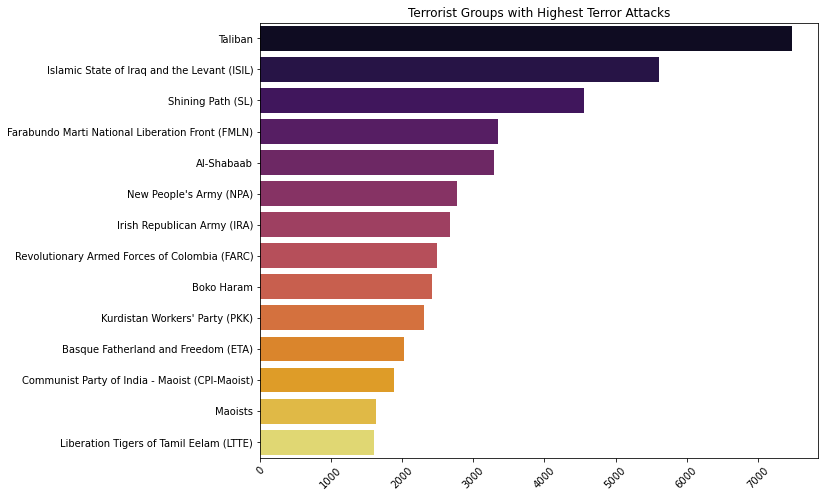

In [23]:
sns.barplot(df_terrorism['Group'].value_counts()[1:15].values,df_terrorism['Group'].value_counts()[1:15].index,palette=('inferno'))
plt.xticks(rotation=45)
fig=plt.gcf()
fig.set_size_inches(10,8)
plt.title('Terrorist Groups with Highest Terror Attacks')
plt.show()

In [24]:
# Activity of Top Terrorist Groups

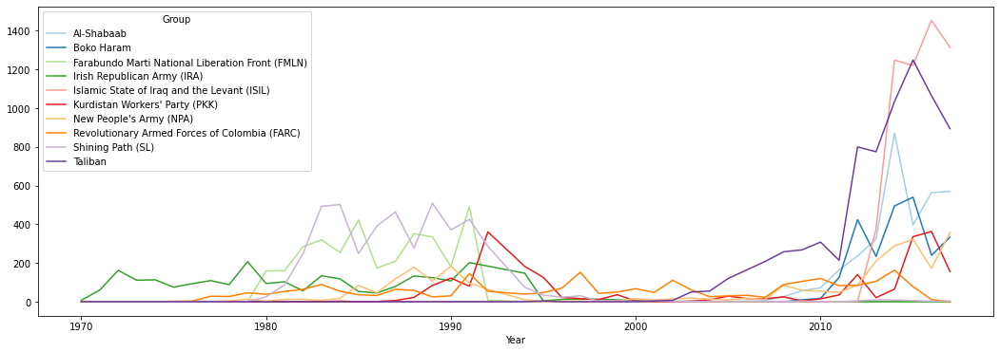

In [25]:
top_groups10=df_terrorism[df_terrorism['Group'].isin(df_terrorism['Group'].value_counts()[1:11].index)]
pd.crosstab(top_groups10.Year,top_groups10.Group).plot(color=sns.color_palette('Paired',10))
fig=plt.gcf()
fig.set_size_inches(18,6)
plt.show()

        The Irish Republican Army(IRA), is the oldest terrorist group started back in the 1960-1970, maybe after the World War 2 due to the mass killing. However, it has probably stopped its activities in the late 90's. Some of the groups that have started lately in 2000's like the ISIL and Taliban, have shown a shoot in the number of attacks in the past years.

#### Terror Activities in:

    * Morocco
    * India
    * United States

In [29]:
terror_morocco = df_terrorism[df_terrorism['Country']=='Morocco']
terror_india   = df_terrorism[df_terrorism['Country']=='India']
terror_usa     = df_terrorism[df_terrorism['Country']=='United States']

In [34]:
terror_morocco_fol=terror_morocco.copy()
terror_morocco_fol.dropna(subset=['latitude','longitude'],inplace=True)
location_ind=terror_morocco_fol[['latitude','longitude']][:5000]
city_ind=terror_morocco_fol['city'][:5000]
killed_ind=terror_morocco_fol['Killed'][:5000]
wound_ind=terror_morocco_fol['Wounded'][:5000]
target_ind=terror_morocco_fol['Target_type'][:5000]

map44 = folium.Map(location=[31.794525, -7.0849336],tiles='CartoDB dark_matter',zoom_start=4.5)
for point in location_ind.index:
    folium.CircleMarker(list(location_ind.loc[point].values),popup='<b>City: </b>'+str(city_ind[point])+'<br><b>Killed: </b>'+str(killed_ind[point])+\
                        '<br><b>Injured: </b>'+str(wound_ind[point])+'<br><b>Target: </b>'+str(target_ind[point]),radius=point_size(killed_ind[point]),color=color_point(killed_ind[point]),fill_color=color_point(killed_ind[point])).add_to(map44)
map44

In [33]:
terror_india_fol=terror_india.copy()
terror_india_fol.dropna(subset=['latitude','longitude'],inplace=True)
location_ind=terror_india_fol[['latitude','longitude']][:5000]
city_ind=terror_india_fol['city'][:5000]
killed_ind=terror_india_fol['Killed'][:5000]
wound_ind=terror_india_fol['Wounded'][:5000]
target_ind=terror_india_fol['Target_type'][:5000]

map5 = folium.Map(location=[20.59, 78.96],tiles='CartoDB dark_matter',zoom_start=4.5)
for point in location_ind.index:
    folium.CircleMarker(list(location_ind.loc[point].values),popup='<b>City: </b>'+str(city_ind[point])+'<br><b>Killed: </b>'+str(killed_ind[point])+\
                        '<br><b>Injured: </b>'+str(wound_ind[point])+'<br><b>Target: </b>'+str(target_ind[point]),radius=point_size(killed_ind[point]),color=color_point(killed_ind[point]),fill_color=color_point(killed_ind[point])).add_to(map5)
map5

In [35]:
terror_usa_fol   =terror_usa.copy()
terror_usa_fol.dropna(subset=['latitude','longitude'],inplace=True)
location_ind    = terror_usa_fol[['latitude','longitude']][:5000]
city_ind        = terror_usa_fol['city'][:5000]
killed_ind      = terror_usa_fol['Killed'][:5000]
wound_ind       = terror_usa_fol['Wounded'][:5000]
target_ind      = terror_usa_fol['Target_type'][:5000]

map6 = folium.Map(location=[39.50, -98.35],tiles='CartoDB dark_matter',zoom_start=4.5)
for point in location_ind.index:
    folium.CircleMarker(list(location_ind.loc[point].values),popup='<b>City: </b>'+str(city_ind[point])+'<br><b>Killed: </b>'+str(killed_ind[point])+\
                        '<br><b>Injured: </b>'+str(wound_ind[point])+'<br><b>Target: </b>'+str(target_ind[point]),radius=point_size(killed_ind[point]),color=color_point(killed_ind[point]),fill_color=color_point(killed_ind[point])).add_to(map6)
map6

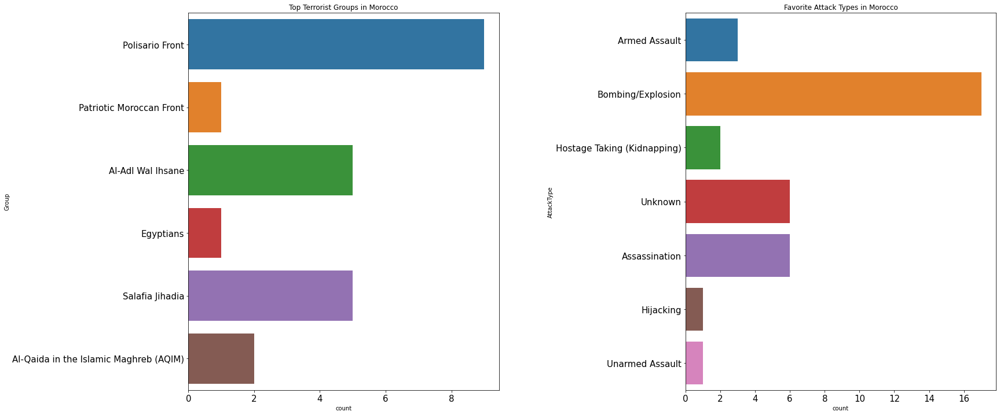

In [39]:
# Most Notorious Groups in Morocco and Favorite Attack Types

f,ax=plt.subplots(1,2,figsize=(25,12))
ind_groups=terror_morocco['Group'].value_counts()[1:11].index
ind_groups=terror_morocco[terror_morocco['Group'].isin(ind_groups)]
sns.countplot(y='Group',data=ind_groups,ax=ax[0])
ax[0].set_title('Top Terrorist Groups in Morocco')
sns.countplot(y='AttackType',data=terror_morocco,ax=ax[1])
ax[1].set_title('Favorite Attack Types in Morocco')
plt.subplots_adjust(hspace=0.3,wspace=0.6)
ax[0].tick_params(labelsize=15)
ax[1].tick_params(labelsize=15)
plt.show()

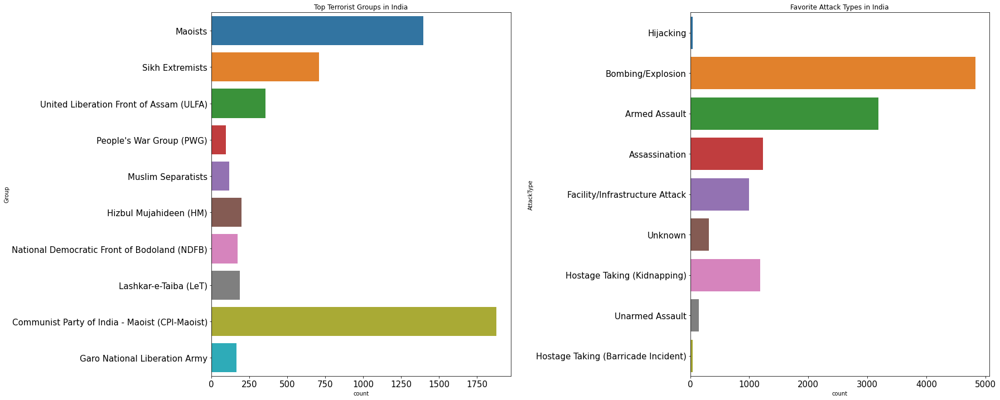

In [38]:
# Most Notorious Groups in India and Favorite Attack Types

f,ax=plt.subplots(1,2,figsize=(25,12))
ind_groups=terror_india['Group'].value_counts()[1:11].index
ind_groups=terror_india[terror_india['Group'].isin(ind_groups)]
sns.countplot(y='Group',data=ind_groups,ax=ax[0])
ax[0].set_title('Top Terrorist Groups in India')
sns.countplot(y='AttackType',data=terror_india,ax=ax[1])
ax[1].set_title('Favorite Attack Types in India')
plt.subplots_adjust(hspace=0.3,wspace=0.6)
ax[0].tick_params(labelsize=15)
ax[1].tick_params(labelsize=15)
plt.show()

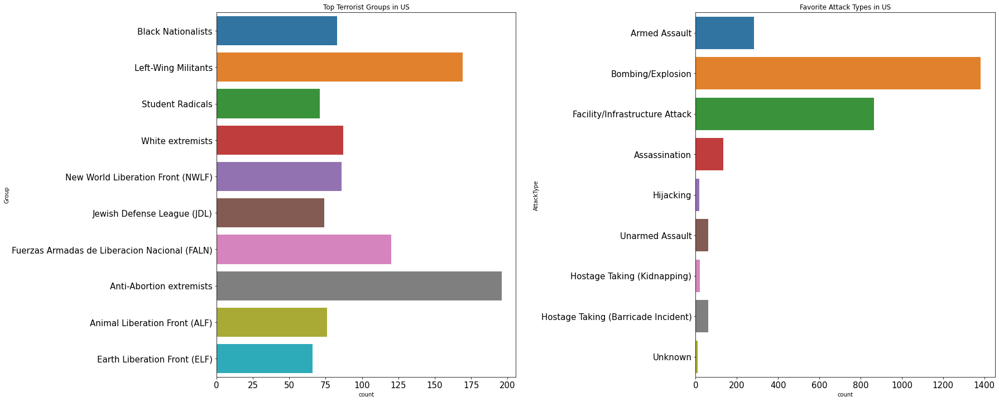

In [40]:
# Most Notorious Groups in US and Favorite Attack Types

f,ax=plt.subplots(1,2,figsize=(25,12))
ind_groups=terror_usa['Group'].value_counts()[1:11].index
ind_groups=terror_usa[terror_usa['Group'].isin(ind_groups)]
sns.countplot(y='Group',data=ind_groups,ax=ax[0])
ax[0].set_title('Top Terrorist Groups in US')
sns.countplot(y='AttackType',data=terror_usa,ax=ax[1])
ax[1].set_title('Favorite Attack Types in US')
plt.subplots_adjust(hspace=0.3,wspace=0.6)
ax[0].tick_params(labelsize=15)
ax[1].tick_params(labelsize=15)
plt.show()

In [ ]:
# Thank you for watching